<a href="https://colab.research.google.com/github/Kh0uloud/Optimization-for-City-Public-Transport-Route/blob/main/Transform_the_problem_into_TSP.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from math import radians, cos, sin, asin, sqrt
import numpy as np
import json

In [ ]:
df = pd.read_csv("/content/drive/MyDrive/Bio_Inspired_Project/Data/data2023_06.csv")

In [ ]:
df

,trip_id,ritnumber,sequence,time,stop_id,lat,lon,stop_code,stop_name,departure,classification,seats,operator,passengers,timestamp,elevation
0,168758612,4016,1,06:24,2511899,51.92499,4.46889,RTD,Rotterdam Centraal,RTD,2,600,NS,198,1687242240,0
1,168758612,4016,1,06:24,2511899,51.92499,4.46889,RTD,Rotterdam Centraal,RTD,2,600,NS,198,1687242240,0
2,168758612,4016,1,06:24,2511899,51.92499,4.46889,RTD,Rotterdam Centraal,RTD,2,480,NS,158,1687242240,0
3,168758612,4016,1,06:24,2511899,51.92499,4.46889,RTD,Rotterdam Centraal,RTD,2,600,NS,198,1687242240,0
4,168758612,4016,1,06:24,2511899,51.92499,4.46889,RTD,Rotterdam Centraal,RTD,2,600,NS,198,1687242240,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2162349,166111090,2985,31,00:46,2512035,51.00164,5.85868,STD,Sittard,STD,2,400,NS,132,1687221960,0
2162350,166111090,2985,31,00:46,2512035,51.00164,5.85868,STD,Sittard,STD,2,400,NS,132,1687221960,0
2162351,166111090,2985,31,00:46,2512035,51.00164,5.85868,STD,Sittard,STD,2,400,NS,132,1687221960,0
2162352,166111090,2985,31,00:46,2512035,51.00164,5.85868,STD,Sittard,STD,2,600,NS,198,1687221960,0


In [ ]:
df= df.drop_duplicates()

In [ ]:
df

,trip_id,ritnumber,sequence,time,stop_id,lat,lon,stop_code,stop_name,departure,classification,seats,operator,passengers,timestamp,elevation
0,168758612,4016,1,06:24,2511899,51.924990,4.468890,RTD,Rotterdam Centraal,RTD,2,600,NS,198,1687242240,0
2,168758612,4016,1,06:24,2511899,51.924990,4.468890,RTD,Rotterdam Centraal,RTD,2,480,NS,158,1687242240,0
8,168249727,4034,1,10:54,2511899,51.924990,4.468890,RTD,Rotterdam Centraal,RTD,2,600,NS,198,1687258440,0
15,168249727,4034,1,10:54,2511899,51.924990,4.468890,RTD,Rotterdam Centraal,RTD,2,480,NS,158,1687258440,0
16,168249791,4038,1,11:54,2511899,51.924990,4.468890,RTD,Rotterdam Centraal,RTD,2,600,NS,198,1687262040,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2162325,166111090,2985,30,00:44,2512035,51.016196,5.858848,STD,Sittard,STD,2,400,NS,132,1687221840,0
2162334,166111090,2985,31,00:45,2512035,51.001640,5.858680,STD,Sittard,STD,2,600,NS,198,1687221900,0
2162335,166111090,2985,31,00:45,2512035,51.001640,5.858680,STD,Sittard,STD,2,400,NS,132,1687221900,0
2162344,166111090,2985,31,00:46,2512035,51.001640,5.858680,STD,Sittard,STD,2,600,NS,198,1687221960,0


In [ ]:
grouped = df.groupby('trip_id').size().reset_index(name='count')
sorted_trip_ids = grouped.sort_values(by='count', ascending=False)['trip_id'].tolist()

In [ ]:
def haversine(lon1, lat1, lon2, lat2):
    """
    Calculate the great circle distance between two points
    on the earth (specified in decimal degrees)
    """
    # Convert decimal degrees to radians
    lon1, lat1, lon2, lat2 = map(radians, [lon1, lat1, lon2, lat2])

    # Haversine formula
    dlon = lon2 - lon1
    dlat = lat2 - lat1
    a = sin(dlat/2)**2 + cos(lat1) * cos(lat2) * sin(dlon/2)**2
    c = 2 * asin(sqrt(a))
    km = 6367 * c  # Radius of earth in kilometers. Use 3956 for miles
    return km

Transform the dataset of train trips into a TSP-like problem formulation, where train stations represent the cities to be visited, and the distances between stations determine the edge weights. <br>
The code provides a visualization of the train stations' locations, their sequences, and the distances between them. This visualization serves as a basis for further applying the ACO algorithm to solve the TSP, optimizing the order of visiting the train stations for each trip, or maaby changes will happen inter-trips.

In [ ]:
dfs = {}  # Dictionary to store the DataFrames
dfTrips = {}  # Dictionary to show the trips
#dfDist = {}  # Dictionary to store distances between Train Stations
#LTrainStations= []   #List of Train Stations we will take into consideration

sorted_trip_ids_used= sorted_trip_ids[:]

"""
cmap = plt.get_cmap('tab20')
colors = cmap(np.linspace(0, 1, len(sorted_trip_ids_used)))

plt.figure(figsize=(1200, 800))
fig, ax = plt.subplots()
"""

for i in range(len(sorted_trip_ids_used)):
    print('Iteration ', i, 'started')
    var1 = f"df1_{i}"

    # Filter the data based on trip_id
    df1 = df[df['trip_id'] == sorted_trip_ids_used[i]]
    df1.drop_duplicates(inplace=True)
    #df1.set_index('sequence', inplace=True)
    df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
    #df1.set_index('time', inplace=True)
    #df1.sort_index(inplace=True)
    # Store the DataFrame in the dictionary
    dfs[var1] = df1

    var2 = f"df2_{i}"

    df2= df1[['trip_id', 'sequence', 'lat', 'lon', 'time', 'passengers']]
    df2.passengers = df2.passengers.astype(int)
    df2.passengers = df2.groupby('time')['passengers'].transform('sum')
    df2.set_index('time', inplace=True)
    df2.sort_index(inplace=True)
    df2.drop_duplicates(inplace=True)
    df2.reset_index(inplace=True)

    # Calculate distance
    df2.lon = df2.lon.astype(float)
    df2.lat = df2.lat.astype(float)
    df2['lonshift'] = df2['lon'].shift(1)
    df2['latshift'] = df2['lat'].shift(1)
    df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
    df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
    df2.distance[0]= 0

    dfTrips[var2] = df2

    """
    # Extract longitude and latitude coordinates
    longitudes = list(df2.lon)
    latitudes = list(df2.lat)
    # Plot the train stations with a specific color
    ax.scatter(longitudes, latitudes, color=colors[i], label=var2)
    # Add labels to each point
    a = [[0, 0]]
    for index, row in df2.iterrows():
        if row['sequence'] != a[-1][1]:
            ax.annotate(row['sequence'], (row['lon'], row['lat']))
            a.append([i, row['sequence'], row['lon'], row['lat']])
    a.pop(0)
    LTrainStations.append(a)

    var3 = f"df3_{i}"

    df3=df2[['sequence', 'lon', 'lat', 'distance', 'passengers']]
    df3['distance']= df2.groupby('sequence')['distance'].transform('sum')
    df3.drop_duplicates(inplace=True)
    df3['time']= df2['time']
    df3 = df3[df3['distance'] >= 2]
    df3['sequence'] = df3['sequence'].astype(str)
    df3['sequence'] = df3['sequence'] + '-' + df3['sequence'].shift(-1).astype(str)
    # Drop the last row since it will have NaN value after shifting
    df3 = df3.iloc[:-1]

    dfDist[var3] = df3

    """

    print("____________________________________________________________________ " )
    print("____________________________________________________________________ " )
    print("____________________________________________________________________ " )
    print("____________________________________________________________________ " )

"""
# Set plot title and axis labels
ax.set_title('Actual Train-line network')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
# Add a legend
ax.legend()
plt.show()
"""

Iteration  0 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3 started
____________________________________________________________________ 
______

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
Iteration  10 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  11 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  12 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  13 started
__

<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.sort_index(inplace=True)
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  22 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  23 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  24 started
____________________________________________________________________ 
________________________

<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.sort_index(inplace=True)
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWi

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  32 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  33 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  34 started
____________________________________________________________________ 
________________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  42 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  43 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  44 started
____________________________________________________________________ 
________________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  53 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  54 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  55 started
____________________________________________________________________ 
________________________

<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  64 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  65 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  66 started
____________________________________________________________________ 
________________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  75 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  76 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  77 started
____________________________________________________________________ 
________________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  86 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  87 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  88 started
____________________________________________________________________ 
________________________

<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.sort_index(inplace=True)
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  95 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  96 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  97 started
____________________________________________________________________ 
________________________

<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.distance[0]= 0
<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is t

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  105 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  106 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  107 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.la

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  115 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  116 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  117 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  125 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  126 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  127 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  135 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  136 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  137 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.sort_index(inplace=True)
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  145 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  146 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  147 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  155 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  156 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  157 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.sort_index(inplace=True)
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  165 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  166 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  167 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['lonshift'] = df2['lon'].shift(1)
<ipython-input-9-5544974bb150>:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['latshift'] = df2['lat'].shift(1)
<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_gu

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  177 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  178 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  179 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.la

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  187 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  188 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  189 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

____________________________________________________________________ 
Iteration  197 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  198 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  199 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  200 starte

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  208 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  209 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  210 started
____________________________________________________________________ 
____________

<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.astype(int)
<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#ret

____________________________________________________________________ 
____________________________________________________________________ 
Iteration  218 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  219 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  220 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  226 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  227 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  228 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.sort_index(inplace=True)
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWi

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  235 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  236 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  237 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  245 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  246 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  247 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  256 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  257 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  258 started
____________________________________________________________________ 
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.sort_index(inplace=True)
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWi

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  268 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  269 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  270 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
Iteration  279 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  280 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  281 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  282 starte

<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.la

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  290 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  291 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  292 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  302 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  303 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  304 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

____________________________________________________________________ 
Iteration  313 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  314 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  315 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  316 starte

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  324 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  325 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  326 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  335 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  336 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  337 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  348 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  349 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  350 started
____________________________________________________________________ 
_____________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
Iteration  359 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  360 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  361 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.la

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  371 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  372 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  373 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  384 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  385 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  386 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.sort_index(inplace=True)
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  397 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  398 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  399 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  410 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  411 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  412 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  422 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  423 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  424 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  434 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  435 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  436 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.la

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  445 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  446 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  447 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin


____________________________________________________________________ 
____________________________________________________________________ 
Iteration  457 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  458 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  459 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  469 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  470 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  471 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
Iteration  494 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  495 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  496 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  506 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  507 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  508 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
Iteration  517 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  518 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  519 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.lat.astype(float)
<ipython-input-9-5544974bb150>:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  529 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  530 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  531 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.la

____________________________________________________________________ 
Iteration  541 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  542 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  543 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  544 starte

<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  553 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  554 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  555 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  564 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  565 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  566 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.lat.astype(float)
<ipython-input-9-5544974bb150>:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  576 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  577 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  578 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.astype(int)
<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#ret

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  588 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  589 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  590 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  600 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  601 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  602 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  611 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  612 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  613 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  623 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  624 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  625 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  635 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  636 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  637 started
____________________________________________________________________ 
____________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
Iteration  646 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  647 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  648 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.sort_index(inplace=True)
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  659 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  660 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  661 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  670 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  671 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  672 started
____________________________________________________________________ 
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  681 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  682 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  683 started
____________________________________________________________________ 
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.sort_index(inplace=True)
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  688 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  689 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  690 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  700 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  701 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  702 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.la

____________________________________________________________________ 
Iteration  711 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  712 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  713 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  714 starte

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  723 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  724 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  725 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  735 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  736 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  737 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.la

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  747 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  748 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  749 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  759 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  760 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  761 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.sort_index(inplace=True)
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  770 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  771 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  772 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.sort_index(inplace=True)
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  781 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  782 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  783 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  792 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  793 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  794 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.lat.astype(float)
<ipython-input-9-5544974bb150>:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  803 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  804 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  805 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  812 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  813 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  814 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.sort_index(inplace=True)
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  820 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  821 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  822 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['latshift'] = df2['lat'].shift(1)
<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  831 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  832 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  833 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.lat.astype(float)
<ipython-input-9-5544974bb150>:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['lonshift'] = df2['lon'].shift(1)
<ipython-input-9-5544974bb150>:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  841 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  842 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  843 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
Iteration  849 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  850 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  851 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  852 starte

<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.astype(int)
<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  857 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  858 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  859 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.distance[0]= 0
<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is t

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  867 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  868 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  869 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  879 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  880 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  881 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  890 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  891 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  892 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  896 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  897 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  898 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  901 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  902 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  903 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  905 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  906 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  907 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  910 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  911 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  912 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.sort_index(inplace=True)
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  917 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  918 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  919 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  922 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  923 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  924 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.distance[0]= 0
<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is t

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  928 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  929 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  930 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.sort_index(inplace=True)
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  933 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  934 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  935 started


<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.lat.astype(float)
<ipython-input-9-5544974bb150>:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  936 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  937 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  938 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.sort_index(inplace=True)
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  941 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  942 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  943 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.astype(int)
<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#ret

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  947 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  948 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  949 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.lat.astype(float)
<ipython-input-9-5544974bb150>:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  954 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  955 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  956 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.distance[0]= 0
<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be se

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  959 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  960 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  961 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.astype(int)
<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  964 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  965 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  966 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  970 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  971 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  972 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.la

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  974 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  975 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  976 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  979 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  980 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  981 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.sort_index(inplace=True)
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  984 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  985 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  986 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  989 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  990 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  991 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.distance[0]= 0
<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be se

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  993 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  994 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  995 started
____________________________________________________________________ 
_____________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  998 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  999 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1000 started
____________________________________________________________________ 
___________

<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1002 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1003 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1004 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1007 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1008 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1009 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.astype(int)
<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1011 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1012 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1013 started


<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1014 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1015 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1016 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.distance[0]= 0
<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be se

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1018 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1019 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1020 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1023 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1024 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1025 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.distance[0]= 0
<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is t

____________________________________________________________________ 
Iteration  1031 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1032 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1033 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1034 st

<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.sort_index(inplace=True)
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWi

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1037 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1038 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1039 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.sort_index(inplace=True)
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWi

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1043 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1044 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1045 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['lonshift'] = df2['lon'].shift(1)
<ipython-input-9-5544974bb150>:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['latshift'] = df2['lat'].shift(1)
<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_gu

____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1046 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1047 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1048 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1051 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1052 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1053 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1057 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1058 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1059 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1063 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1064 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1065 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1070 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1071 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1072 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1075 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1076 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1077 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.distance[0]= 0
<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is t

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1079 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1080 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1081 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.sort_index(inplace=True)
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWi

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1084 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1085 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1086 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1089 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1090 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1091 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.astype(int)
<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1095 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1096 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1097 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1099 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1100 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1101 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1104 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1105 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1106 started


<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.astype(int)
<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1107 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1108 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1109 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1111 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1112 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1113 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.distance[0]= 0
<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is t

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1116 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1117 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1118 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1123 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1124 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1125 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.astype(int)
<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1129 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1130 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1131 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1134 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1135 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1136 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.lat.astype(float)
<ipython-input-9-5544974bb150>:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['lonshift'] = df2['lon'].shift(1)
<ipython-input-9-5544974bb150>:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1138 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1139 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1140 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1143 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1144 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1145 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.distance[0]= 0
<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be se

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1148 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1149 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1150 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.sort_index(inplace=True)
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1155 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1156 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1157 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as


____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1159 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1160 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1161 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
_________________

<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1165 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1166 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1167 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['lonshift'] = df2['lon'].shift(1)
<ipython-input-9-5544974bb150>:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['latshift'] = df2['lat'].shift(1)
<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_gu

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1173 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1174 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1175 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1185 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1186 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1187 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.sort_index(inplace=True)
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1197 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1198 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1199 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.sort_index(inplace=True)
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1208 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1209 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1210 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.distance[0]= 0
<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is t

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1219 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1220 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1221 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1230 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1231 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1232 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.distance[0]= 0
<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is t

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1242 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1243 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1244 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1254 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1255 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1256 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1266 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1267 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1268 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.sort_index(inplace=True)
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWi

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1278 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1279 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1280 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1290 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1291 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1292 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.lat.astype(float)
<ipython-input-9-5544974bb150>:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['lonshift'] = df2['lon'].shift(1)
<ipython-input-9-5544974bb150>:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1301 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1302 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1303 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.sort_index(inplace=True)
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython

____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1309 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1310 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1311 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.astype(int)
<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1317 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1318 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1319 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.sort_index(inplace=True)
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1326 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1327 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1328 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.astype(int)
<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#ret

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1335 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1336 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1337 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1348 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1349 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1350 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.distance[0]= 0
<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be se

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1360 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1361 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1362 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.la

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1372 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1373 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1374 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1383 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1384 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1385 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.astype(int)
<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1394 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1395 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1396 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1407 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1408 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1409 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1420 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1421 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1422 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1433 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1434 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1435 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.distance[0]= 0
<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is t

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1445 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1446 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1447 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['latshift'] = df2['lat'].shift(1)
<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1456 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1457 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1458 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1467 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1468 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1469 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1478 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1479 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1480 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1484 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1485 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1486 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.distance[0]= 0
<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be se

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1496 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1497 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1498 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['lonshift'] = df2['lon'].shift(1)
<ipython-input-9-5544974bb150>:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['latshift'] = df2['lat'].shift(1)
<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_gu

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1508 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1509 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1510 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

 1519 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1520 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1521 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1522 started
____________________________________________________________________ 
____

<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1532 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1533 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1534 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1544 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1545 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1546 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.astype(int)
<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#ret

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1556 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1557 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1558 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.astype(int)
<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#ret

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1568 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1569 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1570 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1580 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1581 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1582 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1592 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1593 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1594 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.lat.astype(float)
<ipython-input-9-5544974bb150>:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['lonshift'] = df2['lon'].shift(1)
<ipython-input-9-5544974bb150>:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1604 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1605 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1606 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.la

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1616 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1617 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1618 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1628 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1629 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1630 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.la

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1640 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1641 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1642 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.sort_index(inplace=True)
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWi

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1653 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1654 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1655 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.sort_index(inplace=True)
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWi

 1664 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1665 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1666 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1667 started
____________________________________________________________________ 
____

<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.astype(int)
<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#ret

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1676 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1677 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1678 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1688 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1689 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1690 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.la

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1700 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1701 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1702 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.la

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1712 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1713 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1714 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1724 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1725 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1726 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.astype(int)
<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1731 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1732 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1733 started


<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1734 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1735 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1736 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.lat.astype(float)
<ipython-input-9-5544974bb150>:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['lonshift'] = df2['lon'].shift(1)
<ipython-input-9-5544974bb150>:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1742 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1743 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1744 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1754 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1755 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1756 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.lat.astype(float)
<ipython-input-9-5544974bb150>:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1766 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1767 started


<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1768 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1769 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as


____________________________________________________________________ 
Iteration  1770 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1771 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1772 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1773 s

<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.astype(int)
<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#ret

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1779 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1780 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1781 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.la

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1792 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1793 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1794 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1804 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1805 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1806 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1809 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1810 started


<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.lat.astype(float)
<ipython-input-9-5544974bb150>:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1811 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1812 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1813 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1821 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1822 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1823 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.distance[0]= 0
<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be se

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1834 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1835 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1836 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1848 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1849 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1850 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.la

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1859 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1860 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1861 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.astype(int)
<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#ret

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1872 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1873 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1874 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.distance[0]= 0
<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be se

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1885 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1886 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1887 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

1897 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1898 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1899 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1900 started
____________________________________________________________________ 
_____

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1910 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1911 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1912 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.astype(int)
<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#ret

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1922 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1923 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1924 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.distance[0]= 0
<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is t

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1935 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1936 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1937 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1948 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1949 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1950 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.astype(int)
<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#ret

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1961 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1962 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1963 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.lat.astype(float)
<ipython-input-9-5544974bb150>:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['lonshift'] = df2['lon'].shift(1)
<ipython-input-9-5544974bb150>:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1973 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1974 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1975 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.lat.astype(float)
<ipython-input-9-5544974bb150>:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['lonshift'] = df2['lon'].shift(1)
<ipython-input-9-5544974bb150>:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1985 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1986 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1987 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1998 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  1999 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2000 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.lat.astype(float)
<ipython-input-9-5544974bb150>:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['lonshift'] = df2['lon'].shift(1)
<ipython-input-9-5544974bb150>:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2009 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2010 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2011 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.sort_index(inplace=True)
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2019 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2020 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2021 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2028 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2029 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2030 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.distance[0]= 0
<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be se

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2040 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2041 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2042 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.distance[0]= 0
<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be se

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2052 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2053 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2054 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2062 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2063 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2064 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2072 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2073 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2074 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['latshift'] = df2['lat'].shift(1)
<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2082 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2083 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2084 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['lonshift'] = df2['lon'].shift(1)
<ipython-input-9-5544974bb150>:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['latshift'] = df2['lat'].shift(1)
<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_gu

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2090 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2091 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2092 started
____________________________________________________________________ 
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2099 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2100 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2101 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['lonshift'] = df2['lon'].shift(1)
<ipython-input-9-5544974bb150>:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['latshift'] = df2['lat'].shift(1)
<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_gu

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2108 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2109 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2110 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.astype(int)
<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2118 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2119 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2120 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['latshift'] = df2['lat'].shift(1)
<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2128 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2129 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2130 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.sort_index(inplace=True)
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWi

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2136 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2137 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2138 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2145 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2146 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2147 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2154 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2155 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2156 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.sort_index(inplace=True)
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWi

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2162 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2163 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2164 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2172 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2173 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2174 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2184 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2185 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2186 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2195 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2196 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2197 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.astype(int)
<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2206 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2207 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2208 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.la

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2218 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2219 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2220 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.sort_index(inplace=True)
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWi

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2231 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2232 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2233 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.distance[0]= 0
<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be se

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2244 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2245 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2246 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.distance[0]= 0
<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is t

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2257 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2258 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2259 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.astype(int)
<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2270 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2271 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2272 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2282 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2283 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2284 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2294 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2295 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2296 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.astype(int)
<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#ret

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2305 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2306 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2307 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.astype(int)
<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#ret

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2313 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2314 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2315 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.astype(int)
<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2319 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2320 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2321 started


<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2322 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2323 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2324 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.lat.astype(float)
<ipython-input-9-5544974bb150>:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2326 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2327 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2328 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.astype(int)
<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2331 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2332 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2333 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.astype(int)
<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2337 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2338 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2339 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2341 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2342 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2343 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.astype(int)
<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#ret

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2345 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2346 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2347 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.sort_index(inplace=True)
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2349 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2350 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2351 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.lat.astype(float)
<ipython-input-9-5544974bb150>:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2353 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2354 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2355 started


<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2356 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2357 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2358 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.astype(int)
<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#ret

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2362 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2363 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2364 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.sort_index(inplace=True)
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2366 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2367 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2368 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['latshift'] = df2['lat'].shift(1)
<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2370 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2371 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2372 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2375 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2376 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2377 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['latshift'] = df2['lat'].shift(1)
<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2379 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2380 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2381 started


<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2382 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2383 started


<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-v

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2384 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2385 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2386 started


<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.sort_index(inplace=True)
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2387 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2388 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2389 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.lat.astype(float)
<ipython-input-9-5544974bb150>:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2400 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2401 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2402 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-v

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2413 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2414 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2415 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2426 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2427 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2428 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2438 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2439 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2440 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.distance[0]= 0
<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is t

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2450 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2451 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2452 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.distance[0]= 0
<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be se

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2463 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2464 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2465 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.lat.astype(float)
<ipython-input-9-5544974bb150>:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2477 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2478 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2479 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.astype(int)
<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#


____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2491 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2492 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2493 started
____________________________________________________________________ 
_________________

<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-v

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2503 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2504 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2505 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.la

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2516 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2517 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2518 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.astype(int)
<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#ret

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2529 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2530 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2531 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.la


____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2542 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2543 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2544 started
____________________________________________________________________ 
_________________

<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.la

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2554 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2555 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2556 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.lat.astype(float)
<ipython-input-9-5544974bb150>:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['lonshift'] = df2['lon'].shift(1)
<ipython-input-9-5544974bb150>:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in


____________________________________________________________________ 
Iteration  2567 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2568 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2569 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2570 s

<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.distance[0]= 0
<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is t

started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2580 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2581 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2582 started
____________________________________________________________________ 
__________

<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2592 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2593 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2594 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2604 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2605 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2606 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.astype(int)
<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#ret

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2615 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2616 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2617 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.lat.astype(float)
<ipython-input-9-5544974bb150>:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['lonshift'] = df2['lon'].shift(1)
<ipython-input-9-5544974bb150>:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2626 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2627 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2628 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.astype(int)
<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#ret

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2635 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2636 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2637 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2648 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2649 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2650 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2661 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2662 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2663 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2675 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2676 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2677 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2688 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2689 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2690 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.lat.astype(float)
<ipython-input-9-5544974bb150>:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2700 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2701 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2702 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.la

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2712 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2713 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2714 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2725 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2726 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2727 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2738 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2739 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2740 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.lat.astype(float)
<ipython-input-9-5544974bb150>:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['lonshift'] = df2['lon'].shift(1)
<ipython-input-9-5544974bb150>:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2750 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2751 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2752 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['latshift'] = df2['lat'].shift(1)
<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2760 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2761 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2762 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2769 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2770 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2771 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.distance[0]= 0
<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be se

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2779 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2780 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2781 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2788 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2789 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2790 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.sort_index(inplace=True)
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython


Iteration  2796 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2797 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2798 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2799 started
_______________________________________________________________

<ipython-input-9-5544974bb150>:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['lonshift'] = df2['lon'].shift(1)
<ipython-input-9-5544974bb150>:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['latshift'] = df2['lat'].shift(1)
<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_gu

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2805 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2806 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2807 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-v

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2811 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2812 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2813 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2816 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2817 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2818 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.lat.astype(float)
<ipython-input-9-5544974bb150>:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['lonshift'] = df2['lon'].shift(1)
<ipython-input-9-5544974bb150>:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2822 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2823 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2824 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as


____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2827 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2828 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2829 started
____________________________________________________________________ 
_________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2831 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2832 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2833 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.sort_index(inplace=True)
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2835 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2836 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2837 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['latshift'] = df2['lat'].shift(1)
<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2839 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2840 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2841 started


<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.astype(int)
<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2842 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2843 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2844 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.astype(int)
<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#ret

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2846 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2847 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2848 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['latshift'] = df2['lat'].shift(1)
<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2851 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2852 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2853 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.lat.astype(float)
<ipython-input-9-5544974bb150>:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['lonshift'] = df2['lon'].shift(1)
<ipython-input-9-5544974bb150>:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2855 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2856 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2857 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.astype(int)
<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#ret

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2859 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2860 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2861 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2865 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2866 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2867 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2871 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2872 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2873 started


<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.distance[0]= 0
<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is t

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2874 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2875 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2876 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

____________________________________________________________________ 
Iteration  2881 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2882 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2883 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2884 st

<ipython-input-9-5544974bb150>:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['lonshift'] = df2['lon'].shift(1)
<ipython-input-9-5544974bb150>:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['latshift'] = df2['lat'].shift(1)
<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_gu

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2893 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2894 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2895 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.la

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2906 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2907 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2908 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.distance[0]= 0
<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is t

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2919 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2920 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2921 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2932 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2933 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2934 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['latshift'] = df2['lat'].shift(1)
<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2944 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2945 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2946 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2956 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2957 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2958 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.la

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2968 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2969 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2970 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2981 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2982 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2983 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.lat.astype(float)
<ipython-input-9-5544974bb150>:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2995 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2996 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  2997 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3009 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3010 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3011 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3022 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3023 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3024 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['latshift'] = df2['lat'].shift(1)
<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3035 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3036 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3037 started
____________________________________________________________________ 
__________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3046 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3047 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3048 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3059 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3060 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3061 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3072 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3073 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3074 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.distance[0]= 0
<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is t

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3084 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3085 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3086 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.astype(int)
<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#ret

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3097 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3098 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3099 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3110 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3111 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3112 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.lat.astype(float)
<ipython-input-9-5544974bb150>:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3124 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3125 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3126 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3138 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3139 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3140 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.lat.astype(float)
<ipython-input-9-5544974bb150>:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3152 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3153 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3154 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3166 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3167 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3168 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.lat.astype(float)
<ipython-input-9-5544974bb150>:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['lonshift'] = df2['lon'].shift(1)
<ipython-input-9-5544974bb150>:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3180 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3181 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3182 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3193 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3194 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3195 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.astype(int)
<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#ret

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3206 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3207 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3208 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3219 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3220 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3221 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.astype(int)
<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#ret

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3231 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3232 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3233 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3245 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3246 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3247 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.distance[0]= 0
<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is t

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3259 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3260 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3261 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as


____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3273 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3274 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3275 started
____________________________________________________________________ 
_________________

<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.la

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3286 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3287 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3288 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:36: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.sort_index(inplace=True)
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWi

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3299 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3300 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3301 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3313 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3314 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3315 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.astype(int)
<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#ret

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3327 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3328 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3329 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.distance[0]= 0
<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is t

started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3342 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3343 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3344 started
____________________________________________________________________ 
__________

<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.la

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3355 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3356 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3357 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.astype(int)
<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3368 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3369 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3370 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.astype(int)
<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#ret

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3380 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3381 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3382 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3392 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3393 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3394 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3405 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3406 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3407 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3418 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3419 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3420 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop(['lonshift', 'latshift'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3431 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3432 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3433 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3443 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3444 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3445 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.la

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3457 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3458 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3459 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.distance[0]= 0
<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is t

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3470 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3471 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3472 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-v

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3480 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3481 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3482 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.lat.astype(float)
<ipython-input-9-5544974bb150>:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing


____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3486 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3487 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3488 started


<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.astype(int)
<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#ret

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3489 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3490 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3491 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3494 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3495 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3496 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['latshift'] = df2['lat'].shift(1)
<ipython-input-9-5544974bb150>:45: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['distance'] = df2.apply(lambda x: haversine(x['lonshift'], x['latshift'], x['lon'], x['lat']), axis=1)
<ipython-input-9-5544974bb150>:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/st

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3498 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3499 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3500 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lon = df2.lon.astype(float)
<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.lat.astype(float)
<ipython-input-9-5544974bb150>:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3503 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3504 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3505 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.lat = df2.lat.astype(float)
<ipython-input-9-5544974bb150>:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['lonshift'] = df2['lon'].shift(1)
<ipython-input-9-5544974bb150>:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/in

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3509 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3510 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3511 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.astype(int)
<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3514 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3515 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3516 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:47: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.distance[0]= 0
<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is t

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3521 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3522 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3523 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3527 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3528 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3529 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as


Iteration  3531 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3532 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3533 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3534 started
_______________________________________________________________

<ipython-input-9-5544974bb150>:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.groupby('time')['passengers'].transform('sum')
<ipython-input-9-5544974bb150>:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:41: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-v

____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3541 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3542 started
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
____________________________________________________________________ 
Iteration  3543 started
____________________________________________________________________ 
__________________

<ipython-input-9-5544974bb150>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop_duplicates(inplace=True)
<ipython-input-9-5544974bb150>:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df1.drop(['ritnumber', 'operator', 'elevation'], axis=1, inplace=True)
<ipython-input-9-5544974bb150>:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2.passengers = df2.passengers.as

"\n# Set plot title and axis labels\nax.set_title('Actual Train-line network')\nax.set_xlabel('Longitude')\nax.set_ylabel('Latitude')\n# Add a legend\nax.legend()\nplt.show()\n"

In [ ]:
Repeated_Trains = []   #Dictionary to store the times at which, a specific trip is repeated

for j in range(len(sorted_trip_ids_used)):
    if dfTrips.get('df2_'+str(j)) is not None :
        l=[]
        for i in range(j, len(sorted_trip_ids_used)):
            if dfTrips.get('df2_'+str(i)) is not None :
                if dfTrips['df2_'+str(j)][['sequence', 'lat', 'lon']].equals(dfTrips['df2_'+str(i)][['sequence', 'lat', 'lon']]) ==True :
                    l.append(['df2_'+str(i), dfTrips['df2_'+str(i)].time.iloc[0]])

        #Add the different schedules at which the trip is repeated
        Repeated_Trains.append( [dfTrips[l[0][0]].trip_id.iloc[0], [item[1] for item in l]] )

        if len(l)>1 :
            l= sorted(l, key=lambda x: x[1])

            #Delete the datasets of the same trip
            for key in [item[0] for item in l]:
                dfTrips.pop(key, None)
                #dfs.pop(key, None)
                #dfDist.pop(key, None)


In [ ]:
#Delete trips which visit less then 3 stations

i= 0
while i < len(dfTrips):
    if len(dfTrips[list(dfTrips.keys())[i]]) < 3:
        dfTrips.pop(list(dfTrips.keys())[i], None)
    else:
        i+=1

dfTrips is a dictionary in which we have the following columns: <br>
'trip_id', 'sequence', 'lat', 'lon', 'time', 'passengers', 'distance' <br>
This dictionary will be the base from which we'll be creating the ACO matrices <br>
Matrices will be computed each time with a different objective function <br>
using distance, crowdness ('passengers'), and 'time'

<Figure size 120000x80000 with 0 Axes>

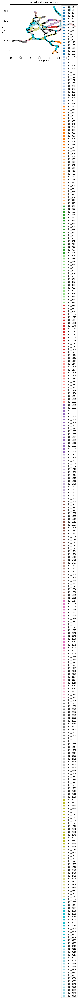

In [ ]:
LTrainStations= []

cmap = plt.get_cmap('tab20')
colors = cmap(np.linspace(0, 1, len(dfTrips)))
plt.figure(figsize=(1200, 800))
fig, ax = plt.subplots()

i=0
for j in dfTrips.keys():
    # Extract longitude and latitude coordinates
    longitudes = list(dfTrips[j].lon)
    latitudes = list(dfTrips[j].lat)
    # Plot the train stations with a specific color
    ax.scatter(longitudes, latitudes, color=colors[i], label=j, marker='s', s=30)
    # Add labels to each point
    a = [[0, 0]]
    for index, row in dfTrips[j].iterrows():
        if row['sequence'] != a[-1][1]:
            ax.scatter(row['lon'], row['lat'], color='black', marker='s', s=10)
            a.append([i, row['sequence'], row['lon'], row['lat']])
    a.pop(0)
    LTrainStations.append(a)
    i+=1

# Set plot title and axis labels
ax.set_title('Actual Train-line network')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
# Add a legend
ax.legend()
plt.show()

"\n# Set plot title and axis labels\nax.set_title('Actual Train-line network')\nax.set_xlabel('Longitude')\nax.set_ylabel('Latitude')\nplt.show()"

Error in callback <function _draw_all_if_interactive at 0x7f7219a3a0e0> (for post_execute):


ValueError: ignored

<Figure size 120000x80000 with 0 Axes>

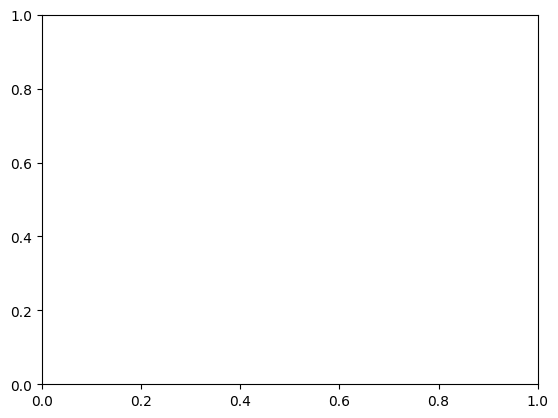

In [ ]:
LTrainStations= []

cmap = plt.get_cmap('tab20')
colors = cmap(np.linspace(0, 1, len(dfTrips)))
plt.figure(figsize=(1200, 800))
fig, ax = plt.subplots()

i=0
for j in dfTrips.keys():
    # Extract longitude and latitude coordinates
    #longitudes = list(dfTrips[j].lon)
    #latitudes = list(dfTrips[j].lat)
    # Plot the train stations with a specific color
    #ax.scatter(longitudes, latitudes, color=colors[i], label=j, marker='s', s=30)
    # Add labels to each point
    a = [[0, 0]]
    for index, row in dfTrips[j].iterrows():
        if row['sequence'] != a[-1][1]:
            #ax.scatter(row['lon'], row['lat'], color='black', marker='s', s=10)
            a.append([i, row['sequence'], row['lon'], row['lat']])
    a.pop(0)
    LTrainStations.append(a)
    i+=1
"""
# Set plot title and axis labels
ax.set_title('Actual Train-line network')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
plt.show()"""

Next step <br>
==> Apply ACO <br>
==> See the real map (search for the place in which we're trying to apply a transport re-routing), and apply ACO (maybe in will change the station locations) <br>

In crowded places, we can add stations for example

In [ ]:
#Fetch maximum number of stations in a trip
nbrStations= max(len(LTrainStations[i]) for i in range (len(LTrainStations)))

#We will represent the stations as a sequence with the trip number of 3 numbers,
#which represent the trip number (000 to 341)
#then 2 numbers which represent the station number (01 to 51=nbrStations)

dfDist = {}  # Dictionary to store distances between Train Stations
Stations= dfTrips[list(dfTrips.keys())[0]][['sequence', 'lon', 'lat', 'distance', 'passengers', 'time']]
Stations['distance']= Stations.groupby('sequence')['distance'].transform('sum')
Stations = Stations.drop_duplicates(subset='sequence', keep='last')
Stations['station'] = Stations['sequence'].apply(lambda x: '{:03d}'.format(0)+'{:02d}'.format(x))
Stations['sequence']= Stations['sequence'].astype(str)
Stations= pd.concat([Stations.iloc[0].to_frame().T, Stations[Stations['distance']>=2]], axis=0)
Stations['seq'] = Stations['sequence'].shift(+1) + '-' + Stations['sequence'].astype(str)

for j in range(1, len(dfTrips)):
    df3=dfTrips[list(dfTrips.keys())[j]][['sequence', 'lon', 'lat', 'distance', 'passengers', 'time']]
    df3['distance']= df3.groupby('sequence')['distance'].transform('sum')
    df3 = df3.drop_duplicates(subset='sequence', keep='last')
    df3['sequence'] = df3['sequence'].astype(int)
    df3['station'] = df3['sequence'].apply(lambda x: '{:03d}'.format(j)+'{:02d}'.format(x))
    Stations = pd.concat([Stations, df3], axis=0)
    Stations['sequence']= Stations['sequence'].astype(str)
    Stations= pd.concat([Stations.iloc[0].to_frame().T, Stations[Stations['distance']>=2]], axis=0)
    Stations['seq'] = Stations['sequence'].shift(+1) + '-' + Stations['sequence'].astype(str)

Stations.set_index('station', inplace=True)

<ipython-input-13-075fe5df4b1e>:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Stations['distance']= Stations.groupby('sequence')['distance'].transform('sum')
<ipython-input-13-075fe5df4b1e>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df3['distance']= df3.groupby('sequence')['distance'].transform('sum')
<ipython-input-13-075fe5df4b1e>:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cavea

#Matrices

In [ ]:
#Number of unique stations (lon, lat)
unique_couples = Stations.groupby(['lon', 'lat']).size().reset_index().rename(columns={0: 'count'})
num_unique_couples = len(unique_couples)

# Create shifted columns for lon and lat
Stations['lon_shifted'] = Stations['lon'].shift(-1)
Stations['lat_shifted'] = Stations['lat'].shift(-1)
Stations['dist'] = Stations['distance'].shift(-1)

Matrix_Stations= []
for i in range (len(unique_couples)):
    Matrix_Stations.append([unique_couples.iloc[i]['lon'], unique_couples.iloc[i]['lat']])

Matrix_Distances= []

for i in range (len(unique_couples)):
    M_Distances= [0]* len(unique_couples)
    for j in range (len(unique_couples)):
        condition = (Stations['lon'] == Matrix_Stations[i][0]) & (Stations['lat'] == Matrix_Stations[i][1]) & (Stations['lon_shifted'] == Matrix_Stations[j][0]) & (Stations['lat_shifted'] == Matrix_Stations[j][1])
        if condition.any():
            M_Distances[j]= Stations[(Stations['lon'] == Matrix_Stations[i][0]) & (Stations['lat'] == Matrix_Stations[i][1]) & (Stations['lon_shifted'] == Matrix_Stations[j][0]) & (Stations['lat_shifted'] == Matrix_Stations[j][1])].iloc[0]['dist']
            if np.isnan(M_Distances[j]) :
                M_Distances[j]= 0
        else:
            M_Distances[j]= 3* haversine(Matrix_Stations[i][0], Matrix_Stations[i][1], Matrix_Stations[j][0], Matrix_Stations[j][1])
    Matrix_Distances.append(M_Distances)

Matrix_Stations= np.array(Matrix_Stations)
Matrix_Distances= np.array(Matrix_Distances)
Matrix_Distances = Matrix_Distances.astype(int)

In [ ]:
Matrix_Stations[:3, :3]

array([[ 3.59535   , 51.44584   ],
       [ 3.59932835, 51.47282513],
       [ 3.60760117, 51.4886221 ]])

In [ ]:
Matrix_Stations[:50, :]

array([[ 3.59535   , 51.44584   ],
       [ 3.59932835, 51.47282513],
       [ 3.60760117, 51.4886221 ],
       [ 3.60779333, 51.48897   ],
       [ 3.60892833, 51.49050833],
       [ 3.62679203, 51.49767595],
       [ 3.62943455, 51.49793602],
       [ 3.63738709, 51.49865005],
       [ 3.63888353, 51.49878441],
       [ 3.65592978, 51.50031256],
       [ 3.69117259, 51.50344069],
       [ 3.69362976, 51.50358425],
       [ 3.86552365, 51.4982224 ],
       [ 3.86591195, 51.49820979],
       [ 3.86837118, 51.49812996],
       [ 3.9026198 , 51.4981772 ],
       [ 3.9049568 , 51.4978328 ],
       [ 3.91552807, 51.49457736],
       [ 3.93481123, 51.48797015],
       [ 3.94011158, 51.48615403],
       [ 3.94329179, 51.48506436],
       [ 3.96875952, 51.47634062],
       [ 3.97132152, 51.47546329],
       [ 4.02172354, 51.46966525],
       [ 4.02460882, 51.46938961],
       [ 4.05328621, 51.4587708 ],
       [ 4.10105516, 51.43971888],
       [ 4.1037093 , 51.43865906],
       [ 4.12520553,

In [ ]:
%cd /content/drive/MyDrive/Bio_Insired_AI/07.Exercises-jupyter

/content/drive/MyDrive/Bio_Insired_AI/07.Exercises-jupyter


In [ ]:
!pip install inspyred
!pip install deap

import collections
collections.Iterable = collections.abc.Iterable
collections.Sequence = collections.abc.Sequence

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.7/88.7 kB 4.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.9/139.9 kB 4.8 MB/s eta 0:00:00


mkdir: cannot create directory ‘/content/drive/MyDrive/Bio_Inspired_Project/Results3’: File exists


/usr/local/lib/python3.10/dist-packages/inspyred/benchmarks.py:947: RuntimeWarning: divide by zero encountered in long_scalars
  self.components = [swarm.TrailComponent((i, j), value=(1 / weights[i][j])) for i, j in itertools.permutations(range(len(weights)), 2)]


Generation: 0
Best Fitness: 0.00017310022503029253
[((83, 7), 0.0058823529411764705), ((7, 29), 0.009615384615384616), ((29, 0), 0.00909090909090909), ((0, 1), 0.1111111111111111), ((1, 2), 0.2), ((2, 8), 0.14285714285714285), ((8, 11), 0.09090909090909091), ((11, 3), 0.05555555555555555), ((3, 4), inf), ((4, 84), 0.00392156862745098), ((84, 94), 0.027777777777777776), ((94, 5), 0.0035714285714285713), ((5, 6), inf), ((6, 38), 0.004273504273504274), ((38, 9), 0.004347826086956522), ((9, 16), 0.0196078431372549), ((16, 10), 0.07692307692307693), ((10, 12), 0.027777777777777776), ((12, 13), inf), ((13, 14), inf), ((14, 22), 0.045454545454545456), ((22, 15), 0.25), ((15, 17), 0.5), ((17, 18), 0.25), ((18, 19), 1.0), ((19, 20), inf), ((20, 21), 0.16666666666666666), ((21, 23), 0.09090909090909091), ((23, 86), 0.0040650406504065045), ((86, 35), 0.004366812227074236), ((35, 24), 0.017857142857142856), ((24, 25), 0.16666666666666666), ((25, 26), 0.09090909090909091), ((26, 73), 0.005780346820

/usr/local/lib/python3.10/dist-packages/inspyred/ec/selectors.py:143: RuntimeWarning: invalid value encountered in double_scalars
  psum[i] /= float(psum[len_pop-1])


Generation: 1
Best Fitness: 0.0002707092582566324
[((2, 3), inf), ((3, 4), inf), ((4, 8), 0.16666666666666666), ((8, 7), inf), ((7, 77), 0.09090909090909091), ((77, 78), inf), ((78, 83), 0.3333333333333333), ((83, 93), 0.25), ((93, 98), 0.004878048780487805), ((98, 97), 1.0), ((97, 0), 0.0033333333333333335), ((0, 1), 0.1111111111111111), ((1, 5), 0.1), ((5, 6), inf), ((6, 9), 0.2), ((9, 10), 0.14285714285714285), ((10, 11), inf), ((11, 14), 0.027777777777777776), ((14, 12), inf), ((12, 13), inf), ((13, 95), 0.007874015748031496), ((95, 36), 0.09090909090909091), ((36, 33), 0.125), ((33, 34), inf), ((34, 96), 0.004347826086956522), ((96, 90), 1.0), ((90, 31), 0.003952569169960474), ((31, 30), inf), ((30, 16), 0.01818181818181818), ((16, 94), 0.004016064257028112), ((94, 29), 0.003952569169960474), ((29, 28), inf), ((28, 27), 0.2), ((27, 26), inf), ((26, 25), 0.09090909090909091), ((25, 22), 0.25), ((22, 21), inf), ((21, 20), 0.16666666666666666), ((20, 19), inf), ((19, 18), 1.0), ((18,

KeyboardInterrupt: ignored

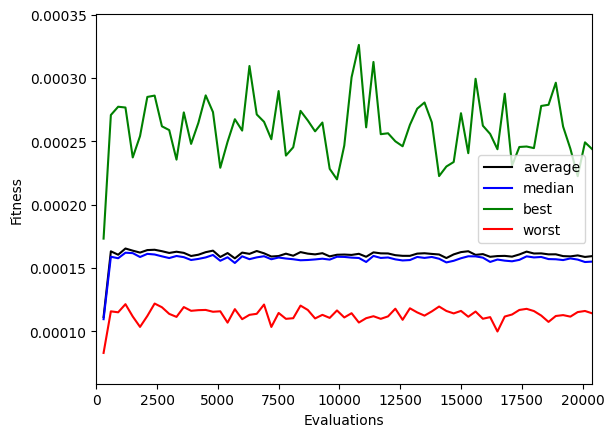

In [ ]:
from utils.utils_07.exercise_1 import *
from utils.utils_07.plot_utils import *
import inspyred.ec

points = Matrix_Stations[:100, :]
distances = Matrix_Distances[:100, :100]

# common parameters
pop_size = 300
max_generations = 100
seed = 0
prng = Random(seed)
display = True
# ACS specific parameters
evaporation_rate = 0.1
learning_rate = 0.1
# EA specific parameters
tournament_size = 5
num_elites = 20

args = {}
args["fig_title"] = "ACS"

!mkdir /content/drive/MyDrive/Bio_Inspired_Project/Results3
# Custom observer function to print generation results
def print_generation_stats(population, num_generations, num_evaluations, args):
    best_fitness = max(population).fitness
    #avg_fitness = sum(population).fitness / len(population)
    print(f"Generation: {num_generations}")
    print(f"Best Fitness: {best_fitness}")
    result_str = f"Generation: {num_generations}\n" \
                 f"Best Fitness: {best_fitness}\n" \
                 f"{str(ac.archive[-1])}\n\n"
    print((ac.archive[-1]))
    with open("/content/drive/MyDrive/Bio_Inspired_Project/Results3/generations.txt", "a") as file:
        file.write(result_str)

# run ACS
problem = inspyred.benchmarks.TSP(distances)
ac = inspyred.swarm.ACS(prng, problem.components)
ac.observer = [print_generation_stats, plot_observer]  # Add custom observer function
ac.terminator = inspyred.ec.terminators.generation_termination
final_pop = ac.evolve(generator=problem.constructor,
                      evaluator=problem.evaluator,
                      bounder=problem.bounder,
                      maximize=problem.maximize,
                      pop_size=pop_size,
                      max_generations=max_generations,
                      evaporation_rate=evaporation_rate,
                      learning_rate=learning_rate,**args)
best_ACS = max(ac.archive)

In [ ]:
args["fig_title"] = "EA"

# run EA
problem = inspyred.benchmarks.TSP(distances)
ea = inspyred.ec.EvolutionaryComputation(prng)
ea.observer = [plot_observer]
ea.selector = inspyred.ec.selectors.tournament_selection
ea.variator = [inspyred.ec.variators.partially_matched_crossover,
               inspyred.ec.variators.inversion_mutation]
ea.replacer = inspyred.ec.replacers.generational_replacement
ea.terminator = inspyred.ec.terminators.generation_termination
final_pop = ea.evolve(generator=problem.generator,
                      evaluator=problem.evaluator,
                      bounder=problem.bounder,
                      maximize=problem.maximize,
                      pop_size=pop_size,
                      max_generations=max_generations,
                      num_selected=pop_size,
                      tournament_size=tournament_size,
                      num_elites=num_elites,**args)
best_EA = max(ea.population)

Best Solution ACS: [2, 3, 4, 9, 16, 15, 17, 29, 28, 30, 31, 32, 26, 98, 62, 61, 52, 51, 56, 96, 97, 79, 75, 1, 0, 5, 6, 7, 8, 10, 11, 12, 94, 13, 14, 20, 19, 18, 21, 92, 88, 86, 90, 91, 85, 99, 81, 80, 82, 89, 87, 76, 50, 47, 46, 48, 43, 27, 34, 33, 35, 36, 77, 72, 67, 44, 45, 41, 49, 84, 69, 68, 42, 37, 38, 25, 22, 24, 23, 93, 95, 65, 63, 64, 78, 83, 60, 40, 39, 53, 74, 73, 70, 71, 66, 59, 58, 55, 54, 57] - Distance: 3067.0


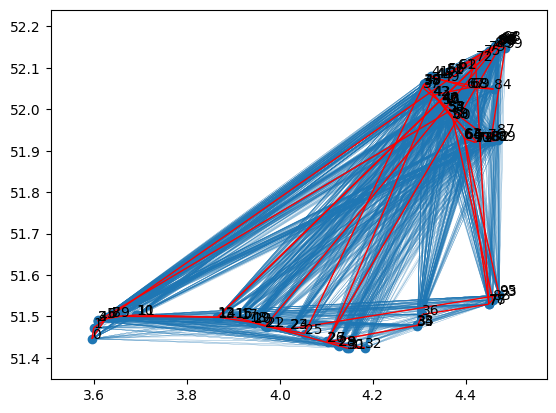

In [ ]:
best_ACS = max(ac.archive)
if display:
    indices = []
    for link in best_ACS.candidate:
        # each point is ((i, j), 1/distance_ij)
        indices.append(link.element[0])
    indices.append(best_ACS.candidate[-1].element[1])
    solution_ACS = indices
    #solution_EA = best_EA.candidate

    print("Best Solution ACS: {0} - Distance: {1}".format(str(solution_ACS), 1/best_ACS.fitness))
    #print("Best Solution EA : {0} - Distance: {1}".format(str(solution_EA), 1/best_EA.fitness))

    plotSolution(points, distances, solution_ACS, "ACS (best solution)")
    #plotSolution(points, distances, solution_EA, "EA (best solution)")

    ioff()
    show()

In [ ]:
extracted_info = []
import re

# Open the file and read line by line
with open('/content/drive/MyDrive/Bio_Inspired_Project/Results3/generations.txt', 'r') as file:
    for line in file:
        # Extract the desired information using regular expressions
        match = re.search(r"\(\([^)]+\), [\d.]+\)", line)
        if match:
            extracted_info.append(match.group())

best_ACS = max(extracted_info)
if display:
    indices = []
    for link in best_ACS.candidate:
        # each point is ((i, j), 1/distance_ij)
        indices.append(link.element[0])
    indices.append(best_ACS.candidate[-1].element[1])
    solution_ACS = indices
    #solution_EA = best_EA.candidate

    print("Best Solution ACS: {0} - Distance: {1}".format(str(solution_ACS), 1/best_ACS.fitness))
    #print("Best Solution EA : {0} - Distance: {1}".format(str(solution_EA), 1/best_EA.fitness))

    plotSolution(points, distances, solution_ACS, "ACS (best solution)")
    #plotSolution(points, distances, solution_EA, "EA (best solution)")

    ioff()
    show()

AttributeError: ignored

<Figure size 120000x80000 with 0 Axes>

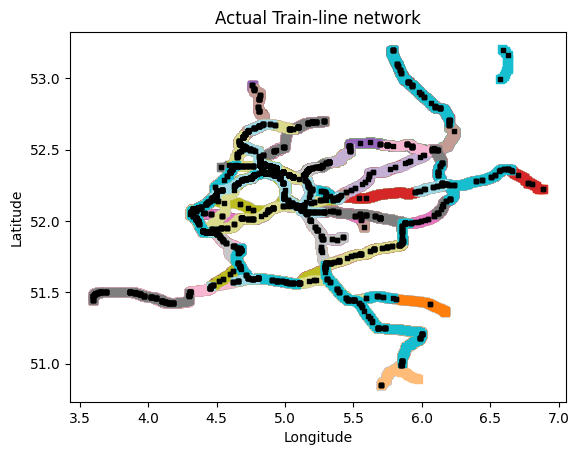

In [ ]:
LTrainStations= []

cmap = plt.get_cmap('tab20')
colors = cmap(np.linspace(0, 1, len(dfTrips)))
plt.figure(figsize=(1200, 800))
fig, ax = plt.subplots()

i=0
for j in dfTrips.keys():
    # Extract longitude and latitude coordinates
    longitudes = list(dfTrips[j].lon)
    latitudes = list(dfTrips[j].lat)
    # Plot the train stations with a specific color
    ax.scatter(longitudes, latitudes, color=colors[i], marker='s', s=30)
    i+=1

for j in range(len(Stations)):
    ax.scatter(Stations['lon'].iloc[j], Stations['lat'].iloc[j], color='black', marker='s', s=10)


# Set plot title and axis labels
ax.set_title('Actual Train-line network')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
plt.show()

In [ ]:
#Matrix construction

In [ ]:
Stations.reset_index(inplace=True)
for row in Stations:
  print(row['lon'], row['lat'])

TypeError: ignored

In [ ]:
Stations

,station,sequence,lon,lat,distance,passengers,time
0,00002,2,5.899102,52.974951,26.972247,415,08:01
1,00004,4,6.096186,52.800856,21.629856,415,08:15
2,00006,6,6.202558,52.704544,12.400052,784,08:24
3,00008,8,6.114198,52.498113,25.357425,1286,08:40
4,00010,10,5.390476,52.164182,63.765325,1286,09:24
...,...,...,...,...,...,...,...
2613,33404,4,4.810924,52.664637,3.905215,198,06:08
2614,33406,6,4.889441,52.678620,4.781057,198,06:13
2615,33502,2,5.381038,52.156615,2.551822,138,00:37
2616,33602,2,4.850928,52.389002,3.651943,330,19:54


In [ ]:
Stations['lon'].iloc[1]

6.096185994668444

In [ ]:
dfTrips.keys()

dict_keys(['df2_15', 'df2_18', 'df2_25', 'df2_26', 'df2_30', 'df2_31', 'df2_43', 'df2_47', 'df2_51', 'df2_75', 'df2_90', 'df2_95', 'df2_119', 'df2_125', 'df2_158', 'df2_192', 'df2_193', 'df2_195', 'df2_197', 'df2_199', 'df2_201', 'df2_205', 'df2_206', 'df2_211', 'df2_241', 'df2_257', 'df2_266', 'df2_270', 'df2_277', 'df2_288', 'df2_291', 'df2_294', 'df2_297', 'df2_298', 'df2_320', 'df2_323', 'df2_336', 'df2_353', 'df2_355', 'df2_358', 'df2_371', 'df2_377', 'df2_382', 'df2_385', 'df2_387', 'df2_396', 'df2_406', 'df2_413', 'df2_425', 'df2_442', 'df2_454', 'df2_462', 'df2_466', 'df2_493', 'df2_501', 'df2_502', 'df2_518', 'df2_523', 'df2_533', 'df2_546', 'df2_550', 'df2_568', 'df2_570', 'df2_571', 'df2_576', 'df2_602', 'df2_614', 'df2_618', 'df2_623', 'df2_630', 'df2_635', 'df2_641', 'df2_642', 'df2_647', 'df2_648', 'df2_653', 'df2_672', 'df2_684', 'df2_685', 'df2_686', 'df2_697', 'df2_718', 'df2_728', 'df2_757', 'df2_786', 'df2_801', 'df2_838', 'df2_843', 'df2_847', 'df2_850', 'df2_855', 

In [ ]:
df3=dfTrips['df2_15'][['sequence', 'lon', 'lat', 'distance', 'passengers', 'time']]
df3['distance']= df3.groupby('sequence')['distance'].transform('sum')
df3 = df3.drop_duplicates(subset='sequence', keep='last')
#df3['time']= dfTrips['df2_15']['time']
#df3 = df3[df3['distance'] >= 2]
#df3['sequence'] = df3['sequence'].astype(str)
#df3['sequence'] = df3['sequence'] + '-' + df3['sequence'].shift(-1).astype(str)
# Drop the last row since it will have NaN value after shifting
#df3 = df3.iloc[:-1]
y=33
df3['station'] = df3['sequence'].apply(lambda x: '{:03d}'.format(y)+'{:02d}'.format(x))
df3

<ipython-input-56-e028db67a6cc>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df3['distance']= df3.groupby('sequence')['distance'].transform('sum')


,sequence,lon,lat,distance,passengers,time,station
0,1,5.792180,53.195950,0.000000,415,07:46,03301
15,2,5.899102,52.974951,26.972247,415,08:01,03302
16,3,5.914420,52.961490,1.813422,415,08:02,03303
29,4,6.096186,52.800856,21.629856,415,08:15,03304
30,5,6.114550,52.791520,1.612089,415,08:16,03305
38,6,6.202558,52.704544,12.400052,784,08:24,03306
39,7,6.197510,52.690830,1.561380,784,08:25,03307
54,8,6.114198,52.498113,25.357425,1286,08:40,03308
55,9,6.091940,52.504720,1.675189,1286,08:41,03309
89,10,5.390476,52.164182,63.765325,1286,09:24,03310
